# COVID-19 datasets

Importing the libraries and dataset.

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px

In [8]:
df_covid = pd.read_csv(r'C:\Users\randf\2023\visualizing\owid-covid-data.csv')

## Figure 3
A histogram showing the evolution of number of newt tests and positive tests per 100000 people over time on weekly basis. I made this figure to see how many tests were done in each continent, how cost-effective that was, and whether the higher cases in some places (europe) are due to more tests done.

In [9]:
df_covid['cases_per_population'] = df_covid['total_cases']/df_covid['population']
df_covid['deaths_per_population'] = df_covid['total_deaths']/df_covid['population']
df_covid['deaths_per_onehundredthousand'] = df_covid['total_deaths']/(df_covid['population']/100000)

In [10]:
df_covid['month'] = pd.DatetimeIndex(df_covid['date']).month
df_covid['year'] = pd.DatetimeIndex(df_covid['date']).year

In [11]:
x=df_covid[['continent','date',"new_tests_smoothed_per_thousand"]].groupby(['continent','date']).sum().reset_index(['continent','date'])
y=df_covid[['continent','date',"positive_rate"]].groupby(['continent','date']).mean().reset_index(['continent','date'])
sub_df_covid= pd.merge(x,y, on = ['continent','date'])
sub_df_covid['positive_tests'] = sub_df_covid['positive_rate']*sub_df_covid['new_tests_smoothed_per_thousand']
sub_df_covid['week_Number'] = pd.DatetimeIndex(sub_df_covid['date']).week
sub_df_covid['year'] = pd.DatetimeIndex(sub_df_covid['date']).year
sub_df_covid['week_Number'] = sub_df_covid['week_Number']+ (sub_df_covid['year'] - sub_df_covid['year'].min()) * 52

C:\Users\randf\AppData\Local\Temp\ipykernel_25012\3929549157.py:5: FutureWarning:

weekofyear and week have been deprecated, please use DatetimeIndex.isocalendar().week instead, which returns a Series. To exactly reproduce the behavior of week and weekofyear and return an Index, you may call pd.Int64Index(idx.isocalendar().week)



In [12]:
fig = px.histogram(sub_df_covid, x="continent", y=["new_tests_smoothed_per_thousand", "positive_tests"],
  animation_frame="week_Number",barmode = 'group',range_y=[0,7727])
fig.show()

## Figure 4
 The distirbution of hospitalized COVID-19 patients per population for each continent each week. I made this figure to see the spread of the number of hodpitalized patients per capita each week and compare it between continents.

In [13]:
df_covid['hospitalized_smoothed_per_population'] = df_covid['weekly_hosp_admissions']/df_covid['population']
sub_df_covid= df_covid[['hospitalized_smoothed_per_population', 'continent', 'date']]
sub_df_covid['week_Number'] = pd.DatetimeIndex(sub_df_covid['date']).week
sub_df_covid['year'] = pd.DatetimeIndex(sub_df_covid['date']).year
sub_df_covid['week_Number'] = sub_df_covid['week_Number']+ (sub_df_covid['year'] - sub_df_covid['year'].min()) * 52

C:\Users\randf\AppData\Local\Temp\ipykernel_25012\4001363095.py:3: FutureWarning:

weekofyear and week have been deprecated, please use DatetimeIndex.isocalendar().week instead, which returns a Series. To exactly reproduce the behavior of week and weekofyear and return an Index, you may call pd.Int64Index(idx.isocalendar().week)

C:\Users\randf\AppData\Local\Temp\ipykernel_25012\4001363095.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\randf\AppData\Local\Temp\ipykernel_25012\4001363095.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/

In [14]:
fig = px.box(sub_df_covid, x="continent", y="hospitalized_smoothed_per_population",
  animation_frame="week_Number", range_y=[0, sub_df_covid['hospitalized_smoothed_per_population'].max()])
fig.show()

## Figure 5
The correlation between the final total deaths per 100000 as a result of covid 19 and the median age, old age, cardiovascualre (per 100000) and diabetes prevelance. I wanted to see in this figure whether the number of deaths correlates with other health factors like smoking, diabetes, cardiovascular diseases, and age.

In [273]:
sub_df_covid =df_covid[['location','deaths_per_onehundredthousand','median_age','female_smokers','male_smokers','aged_65_older','aged_70_older','cardiovasc_death_rate','diabetes_prevalence']].groupby(['location']).max().reset_index('location')


<AxesSubplot:>

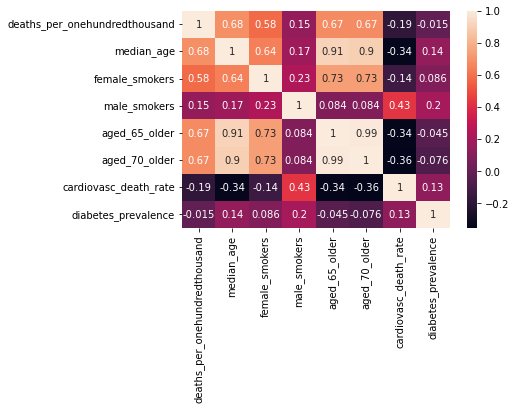

In [274]:
sns.heatmap(sub_df_covid.corr(),annot=True)